# Rastringin's notebook



## Rastringin's plot

C:\Users\jandr\AppData\Local\Temp\ipykernel_8540\2475566910.py:32: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(m)


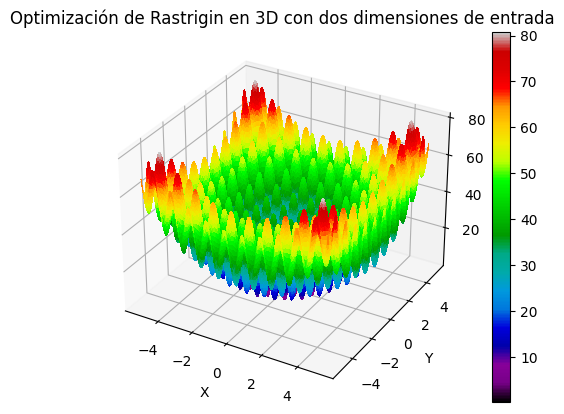

In [2]:
from matplotlib import cm
import math
import matplotlib.pyplot as plt
import numpy as np


# %matplotlib qt


def rastrigin(*X, **kwargs):
    A = kwargs.get('A', 10)
    return A*(2) + sum([(x**2 - A * np.cos(2 * math.pi * x)) for x in X])

if __name__ == '__main__':
    X = np.linspace(-5.2, 5.2, 250)
    Y = np.linspace(-5.2, 5.2, 250)

    X, Y = np.meshgrid(X, Y)

    Z = rastrigin(X, Y, A=10)

    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')
    ax.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap=cm.nipy_spectral, linewidth=0, antialiased=False)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    plt.title('Optimización de Rastrigin en 3D con dos dimensiones de entrada')
    # fig.colorbar(Z)
    # plt.show(ax)
    m = cm.ScalarMappable(cmap=cm.nipy_spectral)
    m.set_array(Z)
    plt.colorbar(m)
    plt.savefig('rastrigin_2D.png')



## Decent gradient

### 2 Dimensions

#### 2 Dimension Decent Gradient

------------------------
iteración  1
x =  -4.4004332488789 , y =  9.22317206738057 z =  53.084988252448134
------------------------
iteración  2
El nuevo valor de x es:  0.15896598466001777
El nuevo valor de y es:  1.1844067583121571
El nuevo valor de z es:  53.084988252448134
x =  0.15896598466001777 , y =  1.1844067583121571 z =  12.009419790569424
------------------------
iteración  3
x =  -5.155911078779947 , y =  -4.809555635540584 z =  12.009419790569424
------------------------
iteración  4
x =  1.0921033779511466 , y =  -9.69603762245352 z =  12.009419790569424
------------------------
iteración  5
x =  -2.562831622203972 , y =  -13.68230854087267 z =  12.009419790569424
------------------------
iteración  6
x =  -4.466826345754899 , y =  -16.669247933900657 z =  12.009419790569424
------------------------
iteración  7
x =  -2.273280174990362 , y =  -18.827030735614876 z =  12.009419790569424
------------------------
iteración  8
x =  4.397463471467498 , y =  -20.6231324423312

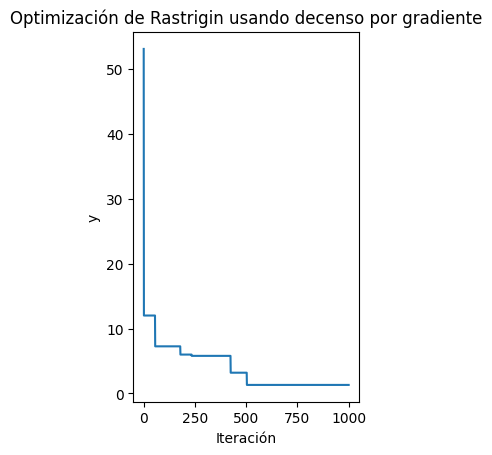

In [138]:
import matplotlib.pyplot as plt
from numpy.random import uniform
from numpy import linspace
import numpy as np
import math


x_inicial = uniform(-5.2, 5.2)
y_inicial = uniform(-5.2, 5.2)
alpha = 0.1
n_iteraciones = 1000

iteraciones = []
w = []


x = x_inicial
y = y_inicial
z = rastrigin(x, y, A=10)
optimo=z
for i in range(n_iteraciones):
	print('------------------------')
	print('iteración ', str(i+1))
	
	# Calcular gradiente
	x = x - alpha*(2*x+20*math.pi*np.sin(2*math.pi*x))
	y = y - alpha*(2*y+20*math.pi*np.sin(2*math.pi*y))
	newz = rastrigin(x,y)
	if z > newz:
		xOp=x
		yOp=y
		zOp=newz
		print('El nuevo valor de x es: ', x)
		print('El nuevo valor de y es: ', y)
		print('El nuevo valor de z es: ', z)
		z = newz
	# Almacenar iteración y valor correspondiente
	w.append(z)
	iteraciones.append(i+1)

	# Imprimir resultados
	print('x = ', str(x), ', y = ', str(y) ,'z = ', str(z))


plt.subplot(1,2,1)
plt.plot(iteraciones,w)
plt.xlabel('Iteración')
plt.ylabel('y')

plt.title('Optimización de Rastrigin usando decenso por gradiente')


print('Los valores optimos encontrados son:\nx: ', str(xOp),'\ny: ', str(yOp),'\nz: ', str(zOp))

#### 2 Dimensions plot

C:\Users\jandr\AppData\Local\Temp\ipykernel_11952\1425890230.py:20: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  img = ax.scatter(xOp, yOp, zOp, cmap='jet')


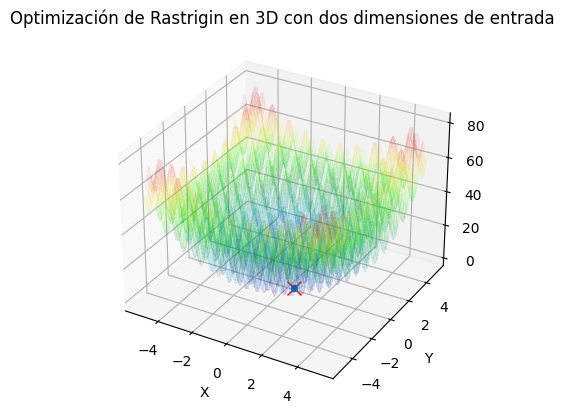

In [136]:
X = np.linspace(-5.2, 5.2, 100)
Y = np.linspace(-5.2, 5.2, 100)

X, Y = np.meshgrid(X, Y)

Z = rastrigin(X, Y, A=10)

fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap=cm.nipy_spectral, linewidth=0, antialiased=False, alpha=0.05)
ax.set_xlabel('X')
ax.set_ylabel('Y')
plt.title('Optimización de Rastrigin en 3D con dos dimensiones de entrada')
# fig.colorbar(Z)
# plt.show(ax)
m = cm.ScalarMappable(cmap=cm.nipy_spectral)
m.set_array(Z)

ax.plot(xOp, yOp, zOp, 'rx', markersize=10)
img = ax.scatter(xOp, yOp, zOp, cmap='jet')




In [ ]:
import pandas as pd
from scipy.spatial import distance_matrix
import matplotlib.pyplot as plt

# Cities coordinates
Ciudades = pd.DataFrame({'long':[-76.30361, -77.28111, -76.19536, -74.08175, -75.69611, -75.68111, -75.51738, -73.25322, -75.88143, -74.76459, -75.51444, -74.78132, -75.56359, -73.1198, -72.50782],
                        'lat':[3.53944, 1.21361, 4.08466, 4.60971, 4.81333, 4.53389, 5.06889, 10.46314, 8.74798, 10.91843, 10.39972, 10.96854, 6.25184, 7.12539, 7.89391]})

# Cities
x = Ciudades['long']
y = Ciudades['lat']

# Set up the figure
plt.scatter(x, y)
plt.title("Ciudades a visitar")
plt.show()

#print(Ciudades)

### 3 Dimensions

#### 3 Dimensions plot

3


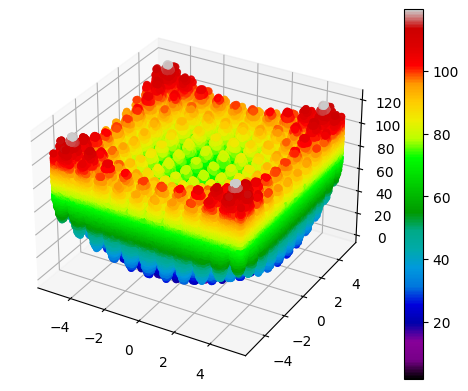

In [3]:
from matplotlib import cm
import math
import matplotlib.pyplot as plt
import numpy as np



# %matplotlib qt


def rastrigin(*X, **kwargs):
    A = kwargs.get('A', 10)
    return A*(3) + sum([(x**2 - A * np.cos(2 * math.pi * x)) for x in X])

if __name__ == '__main__':
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    x = np.linspace(-5.2, 5.2, 100)
    y = np.linspace(-5.2, 5.2, 100)
    z = np.linspace(-5.2, 5.2, 100)

    X, Y, Z = np.meshgrid(x, y, z)

    Z1 = rastrigin(X, Y, Z, A=10)

    img = ax.scatter(X, Y, Z1, c=Z1, cmap=cm.nipy_spectral)
    fig.colorbar(img)
    plt.show()

#### 3 Dimensions Decent Gradient

------------------------
iteración  1
x =  8.99113623860151 , y =  4.843141120630495 z =  5.696991733849303 fx =  49.2846017179174
------------------------
iteración  2
x =  7.54265539970435 , y =  9.112106855820363 z =  9.812470108146206 fx =  49.2846017179174
------------------------
iteración  3
x =  7.698004295513011 , y =  3.2208975278218466 z =  14.973648402720617 fx =  49.2846017179174
------------------------
iteración  4
x =  12.109252014276153 , y =  -3.601716102521128 z =  16.729564263692687 fx =  49.2846017179174
------------------------
iteración  5
x =  5.705145422659503 , y =  -6.62913089360081 z =  24.2868515921423 fx =  49.2846017179174
------------------------
iteración  6
x =  10.599418699316914 , y =  -9.859994051499914 z =  20.143344963838164 fx =  49.2846017179174
------------------------
iteración  7
x =  12.154108033645326 , y =  -12.729422414788228 z =  17.764853041099055 fx =  49.2846017179174
------------------------
iteración  8
x =  4.54646030121453 , y =  

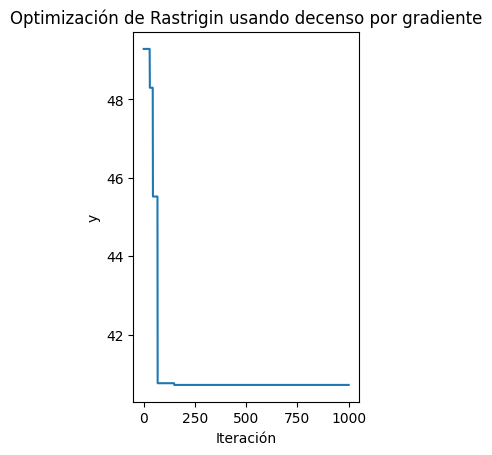

In [13]:
import matplotlib.pyplot as plt
from numpy.random import randint
from numpy import linspace
import numpy as np
import math
from numpy.random import uniform

x_inicial = uniform(-5.2, 5.2)
y_inicial = uniform(-5.2, 5.2)
z_inicial = uniform(-5.2, 5.2)
alpha = 0.1
n_iteraciones = 1000

iteraciones = []
w = []


x = x_inicial
y = y_inicial
z = z_inicial
fx = rastrigin(x,y,z)
optimo=fx
for i in range(n_iteraciones):
	print('------------------------')
	print('iteración ', str(i+1))
	
	# Calcular gradiente
	x = x - alpha*(2*x+20*math.pi*np.sin(2*math.pi*x))
	y = y - alpha*(2*y+20*math.pi*np.sin(2*math.pi*y))
	z = z - alpha*(2*y+20*math.pi*np.sin(2*math.pi*z))
	newfx = rastrigin(x,y,z)
	if fx > newfx:
		xOp=x
		yOp=y
		zOp=z
		fxOp=newfx
		print('El nuevo valor de x es: ', x)
		print('El nuevo valor de y es: ', y)
		print('El nuevo valor de z es: ', z)
		print('El nuevo valor de fx es: ', fx)
		fx = newfx
	# Actualizar "x, y" usando gradiente descendente
	

	# Almacenar iteración y valor correspondiente
	w.append(fx)
	iteraciones.append(i+1)

	# Imprimir resultados
	print('x = ', str(x), ', y = ', str(y) ,'z = ', str(z),'fx = ', str(fx))


plt.subplot(1,2,1)
plt.plot(iteraciones,w)
plt.xlabel('Iteración')
plt.ylabel('y')

plt.title('Optimización de Rastrigin usando decenso por gradiente')


print('Los valores optimos encontrados son:\nx: ', str(xOp),'\ny: ', str(yOp),'\nz: ', str(zOp),'\nfx: ', str(fxOp))




##### 3 Dimensions Decent Gradient Plot

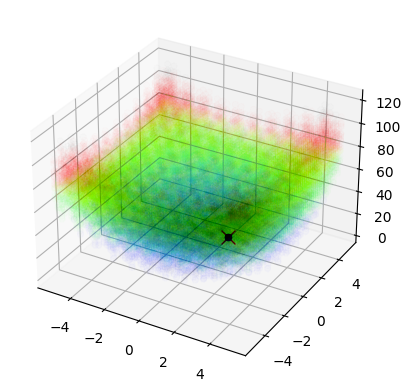

In [90]:
def rastrigin(*X, **kwargs):
    A = kwargs.get('A', 10)
    return A*(3) + sum([(x**2 - A * np.cos(2 * math.pi * x)) for x in X])

if __name__ == '__main__':
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    x = np.linspace(-5.2, 5.2, 50)
    y = np.linspace(-5.2, 5.2, 50)
    z = np.linspace(-5.2, 5.2, 50)

    X, Y, Z = np.meshgrid(x, y, z)

    Z1 = rastrigin(X, Y, Z, A=10)

    

    img = ax.scatter(X, Y, Z1, c=Z1, cmap='jet', alpha=0.004)

    ax.plot(xOp, yOp, zOp, 'rx', markersize=10)
    ax.scatter(xOp, yOp, zOp, c=fxOp, cmap='jet')

    plt.show()

## Differential Evolution algorithm.

### 2 Dimension

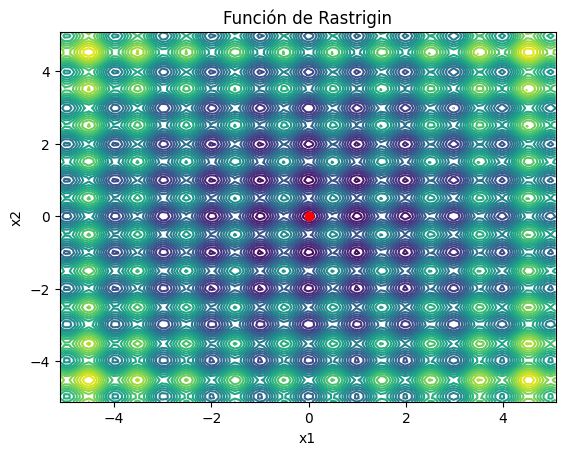

In [7]:
import numpy as np
from scipy.optimize import differential_evolution
import matplotlib.pyplot as plt

def f_rastrigin2d_vec(x):
    x1 = x[0]
    x2 = x[1]
    y = 20 + x1**2 - 10*np.cos(2*np.pi*x1) + x2**2 - 10*np.cos(2*np.pi*x2)
    return y

bounds = [(-5.12, 5.12), (-5.12, 5.12)]
opt_ras01 = differential_evolution(f_rastrigin2d_vec, bounds)

# Plotting the function and the optimum
delta = 0.1
x1, x2 = np.meshgrid(np.arange(-5.12, 5.12, delta), np.arange(-5.12, 5.12, delta))
Z = f_rastrigin2d_vec([x1, x2])

plt.figure()
plt.contour(x1, x2, Z, levels=30)
plt.plot(opt_ras01.x[0], opt_ras01.x[1], 'ro')
plt.title('Función de Rastrigin')
plt.xlabel('x1')
plt.ylabel('x2')
plt.show()

### 3 Dimensions

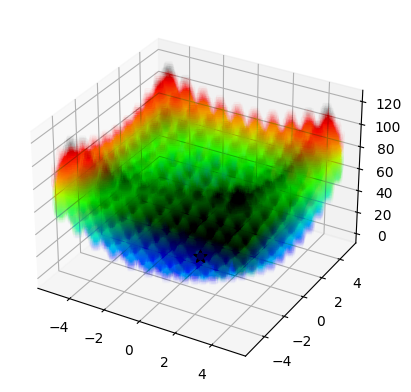

In [114]:
import numpy as np
from scipy.optimize import differential_evolution
import matplotlib.pyplot as plt

def f_rastrigin3d_vec(x):
    x1 = x[0]
    x2 = x[1]
    x3 = x[2]
    y = 30 + x1**2 - 10*np.cos(2*np.pi*x1) + x2**2 - 10*np.cos(2*np.pi*x2) + x3**2 - 10*np.cos(2*np.pi*x3)
    return y

bounds = [(-5.12, 5.12), (-5.12, 5.12), (-5.12, 5.12)]
opt_ras01 = differential_evolution(f_rastrigin2d_vec, bounds)

# Plotting the function and the optimum
delta = 0.1
x1, x2, x3 = np.meshgrid(np.arange(-5.12, 5.12, delta), np.arange(-5.12, 5.12, delta), np.arange(-5.12, 5.12, delta))
Z = f_rastrigin3d_vec([x1, x2, x3])

fig=plt.figure()
ax = fig.add_subplot( projection='3d')
img = ax.scatter(x1, x2, Z, c=Z, cmap='jet', marker=',',alpha=0.002)

# plt.show()
ax.plot(opt_ras01.x[0], opt_ras01.x[1], opt_ras01.x[2], c='black',marker='*',markersize=10)
ax.scatter(opt_ras01.x[0], opt_ras01.x[1], opt_ras01.x[2], c=opt_ras01.x[2])


# ax.plot(xOp, yOp, zOp, 'rx', markersize=10)
# ax.scatter(xOp, yOp, zOp, c=fxOp, cmap='jet')

plt.show()

## Particles swarm optimization

### 2 Dimensions

In [71]:
import pyswarm

def f_rastrigin2d_vec(x):
    x1 = x[0]
    x2 = x[1]
    y = 20 + x1**2 - 10*np.cos(2*np.pi*x1) + x2**2 - 10*np.cos(2*np.pi*x2)
    return y

lb = [-5.12, -5.12]
ub = [5.12, 5.12]

xopt, fopt = pyswarm.pso(f_rastrigin2d_vec, lb, ub, debug=True)



print('The minimum value is: ', str(fopt), '\nwith coordinates x: ', str(xopt[0]), '\nand y: ', str(xopt[1]))

No constraints given.
New best for swarm at iteration 1: [ 1.01111627 -0.92172667] 3.0815027699736
Best after iteration 1: [ 1.01111627 -0.92172667] 3.0815027699736
Best after iteration 2: [ 1.01111627 -0.92172667] 3.0815027699736
Best after iteration 3: [ 1.01111627 -0.92172667] 3.0815027699736
New best for swarm at iteration 4: [-0.9824161  -0.97627822] 2.090102451229285
Best after iteration 4: [-0.9824161  -0.97627822] 2.090102451229285
New best for swarm at iteration 5: [-0.03678767  0.03450952] 0.5026500574268269
Best after iteration 5: [-0.03678767  0.03450952] 0.5026500574268269
Best after iteration 6: [-0.03678767  0.03450952] 0.5026500574268269
Best after iteration 7: [-0.03678767  0.03450952] 0.5026500574268269
New best for swarm at iteration 8: [ 0.03296677 -0.00760641] 0.2263244584538313
Best after iteration 8: [ 0.03296677 -0.00760641] 0.2263244584538313
New best for swarm at iteration 9: [-0.02337212 -0.00548907] 0.11415615325408446
New best for swarm at iteration 9: [-0.

### 3 Dimensions

In [9]:
import numpy as np
import math
import matplotlib.pyplot as plt

# Define the Rastrigin function for three variables
def rastrigin(v):
    """Rastrigin 3D"""
    x, y, z = v
    factor1 = x**2 - (10 * np.cos(2*math.pi*x))
    factor2 = y**2 - (10 * np.cos(2*math.pi*y))
    factor3 = z**2 - (10 * np.cos(2*math.pi*z))
    return (30 + factor1 + factor2 + factor3)



# Define the PSO algorithm
def run_PSO(n_particles=5, n_iterations=350, omega=0.5, phi_p=0.6, phi_g=0.6):
    # Set the lower and upper bounds for the search space
    lo_b = -5.12
    up_b =  5.12

    # Create a list of tuples to represent the search space limits for each dimension
    limits = ([lo_b, up_b], [lo_b, up_b], [lo_b, up_b])

    # Extract the lower and upper bounds for each dimension
    x_lo = limits[0][0]
    x_up = limits[0][1]
    y_lo = limits[1][0]
    y_up = limits[1][1]
    z_lo = limits[2][0]
    z_up = limits[2][1]

    # Initialize the position of the particles
    x_particles = np.zeros((n_iterations, n_particles))
    x_particles[0, :] = np.random.uniform(lo_b, up_b, size=n_particles)

    y_particles = np.zeros((n_iterations, n_particles))
    y_particles[0, :] = np.random.uniform(lo_b, up_b, size=n_particles)

    z_particles = np.zeros((n_iterations, n_particles))
    z_particles[0, :] = np.random.uniform(lo_b, up_b, size=n_particles)

    # Initialize the best-known position of each particle
    x_best_particles = np.copy(x_particles[0, :])
    y_best_particles = np.copy(y_particles[0, :])
    z_best_particles = np.copy(z_particles[0, :])

    # Initialize the objective function values for each particle
    z_objective = np.zeros((n_iterations, n_particles))

    # Evaluate the objective function for each particle at the initial positions
    for i in range(n_particles):
        z_objective[0, i] = rastrigin((x_particles[0, i], y_particles[0, i], z_particles[0, i]))

    # Find the best global position and its index
    z_best_global = np.min(z_objective[0, :])
    index_best_global = np.argmin(z_objective[0, :])

    # Store the best global position
    x_best_p_global = x_particles[0, index_best_global]
    y_best_p_global = y_particles[0, index_best_global]
    z_best_p_global = z_particles[0, index_best_global]

    # Calculate the lower and upper bounds for the velocity
    velocity_lo = lo_b - up_b
    velocity_up = up_b - lo_b

    # Initialize the velocity of the particles
    u_particles = np.zeros((n_iterations, n_particles))
    u_particles[0, :] = 0.1 * np.random.uniform(velocity_lo, velocity_up, size=n_particles)

    v_particles = np.zeros((n_iterations, n_particles))
    v_particles[0, :] = 0.1 * np.random.uniform(velocity_lo, velocity_up, size=n_particles)

    w_particles = np.zeros((n_iterations, n_particles))
    w_particles[0, :] = 0.1 * np.random.uniform(velocity_lo, velocity_up, size=n_particles)

    # Start the main loop for iterations
    iteration = 1
    while iteration <= n_iterations - 1:
        
        # Loop through all particles
        for i in range(n_particles):
            # Get the position and velocity of the current particle
            x_p = x_particles[iteration - 1, i]
            y_p = y_particles[iteration - 1, i]
            z_p = z_particles[iteration - 1, i]

            u_p = u_particles[iteration - 1, i]
            v_p = v_particles[iteration - 1, i]
            w_p = w_particles[iteration - 1, i]

            # Get the best-known position of the current particle
            x_best_p = x_best_particles[i]
            y_best_p = y_best_particles[i]
            z_best_p = z_best_particles[i]

            # Generate random numbers for the personal and global influence factors
            r_p = np.random.uniform(0, 1)
            r_g = np.random.uniform(0, 1)

            # Update the velocity of the particle
            u_p_new = omega * u_p + \
                      phi_p * r_p * (x_best_p - x_p) + \
                      phi_g * r_g * (x_best_p_global - x_p)

            v_p_new = omega * v_p + \
                      phi_p * r_p * (y_best_p - y_p) + \
                      phi_g * r_g * (y_best_p_global - y_p)

            w_p_new = omega * w_p + \
                      phi_p * r_p * (z_best_p - z_p) + \
                      phi_g * r_g * (z_best_p_global - z_p)

            # Update the position of the particle
            x_p_new = x_p + u_p_new
            y_p_new = y_p + v_p_new
            z_p_new = z_p + w_p_new

            # Check if the new position is within the search space limits, otherwise keep the previous position
            if not ((lo_b <= x_p_new <= up_b) and (lo_b <= y_p_new <= up_b) and (lo_b <= z_p_new <= up_b)):
                x_p_new = x_p
                y_p_new = y_p
                z_p_new = z_p

            # Update the position and velocity arrays
            x_particles[iteration, i] = x_p_new
            y_particles[iteration, i] = y_p_new
            z_particles[iteration, i] = z_p_new

            u_particles[iteration, i] = u_p_new
            v_particles[iteration, i] = v_p_new
            w_particles[iteration, i] = w_p_new

            # Calculate the new objective function value for the updated position
            z_p_new_obj = rastrigin((x_p_new, y_p_new, z_p_new))
            z_p_best_obj = rastrigin((x_best_p, y_best_p, z_best_p))

            # Update the objective function array
            z_objective[iteration, i] = z_p_new_obj

            # Check if the new position is better than the previous best-known position for the particle
            if z_p_new_obj < z_p_best_obj:
                # Update the best-known position for the particle
                x_best_particles[i] = x_p_new
                y_best_particles[i] = y_p_new
                z_best_particles[i] = z_p_new

                # Calculate the global best objective function value
                z_p_best_global_obj = rastrigin((x_best_p_global, y_best_p_global, z_best_p_global))

                # Check if the new position is better than the global best position
                if z_p_new_obj < z_p_best_global_obj:
                    # Update the global best position
                    x_best_p_global = x_p_new
                    y_best_p_global = y_p_new
                    z_best_p_global = z_p_new

        # Increment the iteration counter
        iteration = iteration + 1

    # Print the best solution found
    print("Best solution found: ", x_best_p_global, y_best_p_global, z_best_p_global, rastrigin((x_best_p_global, y_best_p_global, z_best_p_global)))

    # Return the list of solutions
    return x_particles, y_particles, z_particles
a = run_PSO()
a = np.array(a)
print(a.shape)

Best solution found:  -1.9890314396502724 0.08876218069133675 -3.0110183723562836 14.593352738457199
(3, 350, 5)


## Genetic Algorithm

### 2 Dimensions

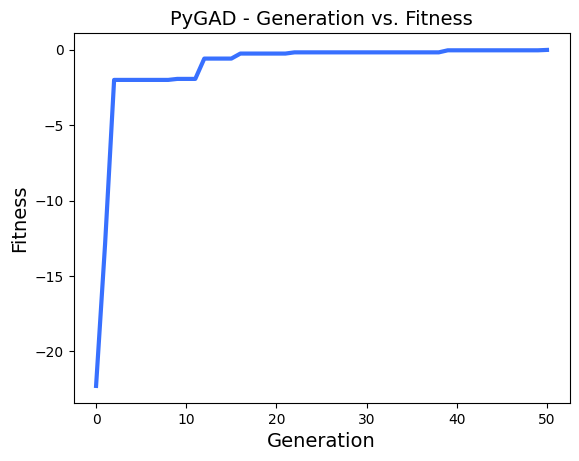

[[1.2157174488388032, -3.3688164405922616], [1.6192034938697377, 4.153561537705494], [4.8742837014700875, 3.661474114315144], [-1.7803100660945201, 3.254328481265878], [4.621916901377061, 1.8823842543866505], [-4.58185012518843, 0.635829804792162], [-3.400035354012918, -2.2395109184471784], [-1.7625537257335466, -4.045186924227036]]


In [14]:
import numpy as np
import pygad
import matplotlib.pyplot as plt


def f_rastrigin2d_vec_inv(x):
    x1 = x[0]
    x2 = x[1]
    y = 20 + x1**2 - 10*np.cos(2*np.pi*x1) + x2**2 - 10*np.cos(2*np.pi*x2)
    return -y

def fitness_func(solution, solution_idx):
    return f_rastrigin2d_vec_inv(solution)

ga_instance = pygad.GA(num_generations=50, num_parents_mating=2, fitness_func=fitness_func, sol_per_pop=10, num_genes=2, init_range_low=-5, init_range_high=5, parent_selection_type="sss", keep_parents=1, crossover_type="single_point", mutation_type="random", mutation_percent_genes=10, save_solutions=True)

ga_instance.run()
ga_instance.plot_fitness()

plt.show()

soluciones_instance = ga_instance.solutions
print(soluciones_instance[0:8])

#### Da plot

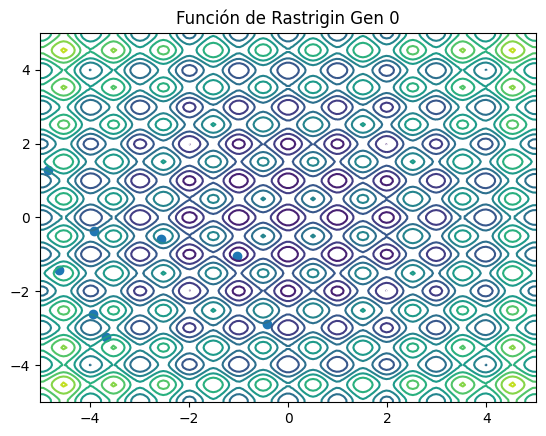

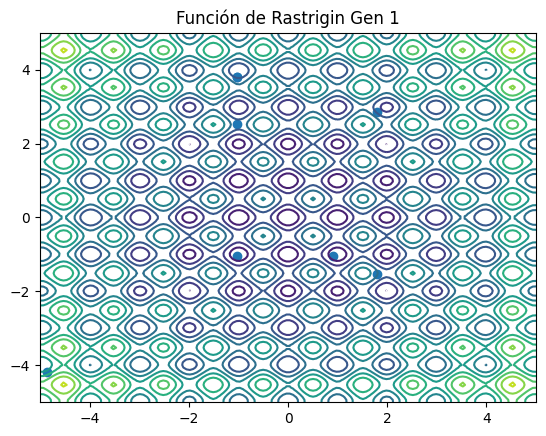

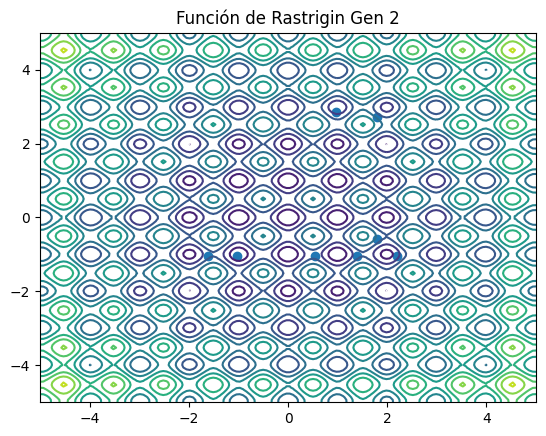

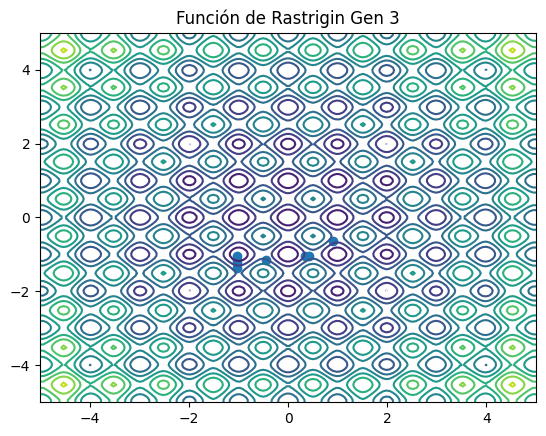

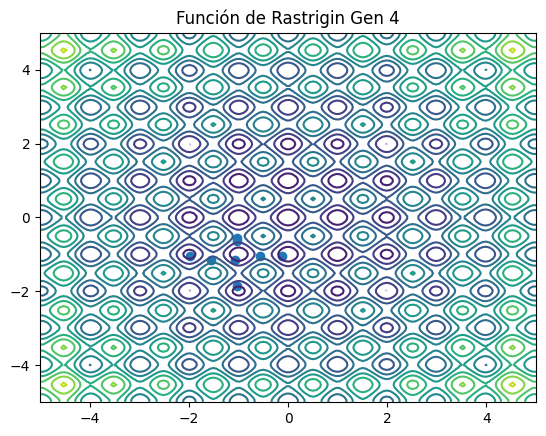

...

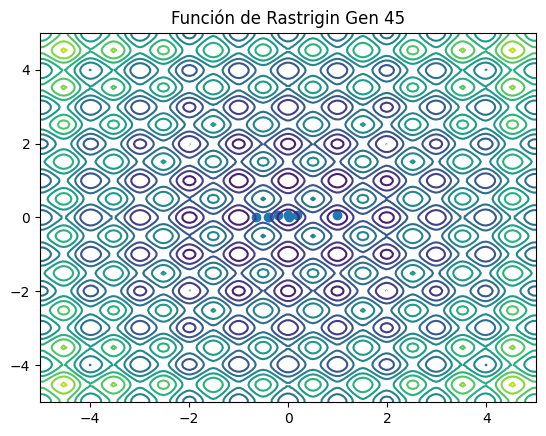

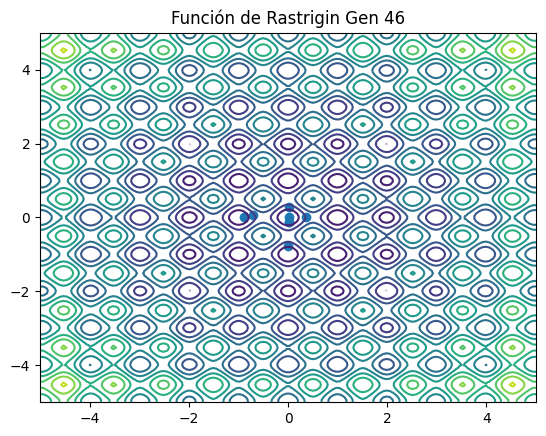

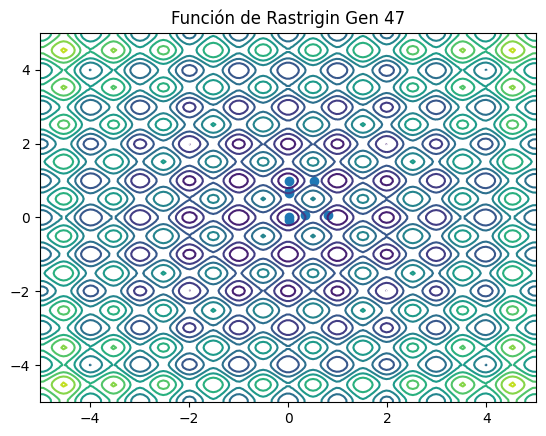

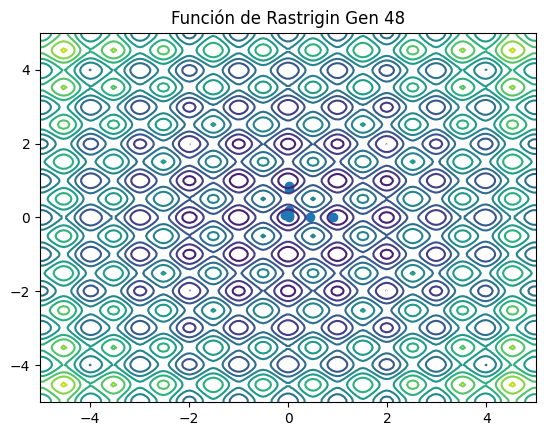

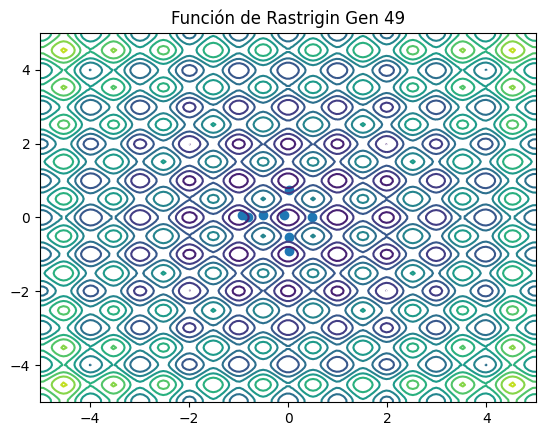

In [7]:
ncols = 150
nrows = 150
X = np.linspace(-5, 5, ncols)     
Y = np.linspace(-5, 5, nrows)     
X, Y = np.meshgrid(X, Y) 

Z = [-f_rastrigin2d_vec_inv([X[i,j], Y[i,j]]) for i in range(nrows) for j in range(ncols)]
Z = np.array(Z).reshape([nrows,ncols])

for j in range(50):
    Pob = np.array(soluciones_instance[j*8:(j+1)*8])
    fig, ax = plt.subplots()
    ax.contour(X,Y,Z, levels = 10)
    ax.scatter(Pob[:,0],Pob[:,1])
    plt.title("Función de Rastrigin Gen " + str(j))
    plt.show()

#### End plot

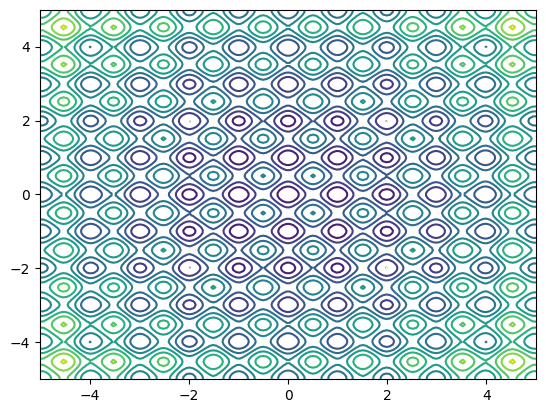

In [9]:
%matplotlib inline

from matplotlib import animation, rc
from IPython.display import HTML

fig, ax = plt.subplots()

ax.set_xlim(( -5, 5))
ax.set_ylim((-5, 5))
ax.contour(X,Y,Z, levels = 10)
scatter, = ax.plot([], [], lw=2)

In [11]:
# initialization function: plot the background of each frame
def init():
    scatter.set_data([], [])
    return (scatter,)

# animation function. This is called sequentially
def animate(i):
    Pob = np.array(soluciones_rosenbrock[i*8:(i+1)*8])
    scatter.set_data(Pob[:,0],Pob[:,1])
    return (scatter,)

# call the animator. blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=50, interval=10, blit=True)

plt.rcParams['animation.ffmpeg_path'] = 'C:\FFmpeg\ffmpeg-20200610-9dfb19b-win64-static\bin\ffmpeg.exe'

HTML(anim.to_html5_video())


RuntimeError: Requested MovieWriter (ffmpeg) not available

### 3 Dimensions

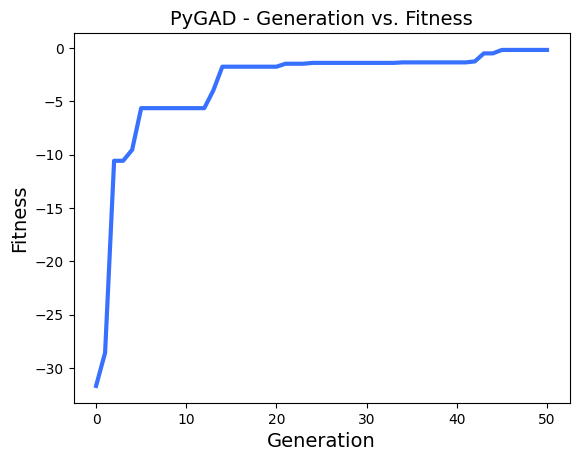

[[0.797480952162454, 2.7500603910958006, 4.291928966476158], [-2.7070398680589514, 4.8607019003306355, 1.144844941319901], [-1.2433690321925353, 0.5806338885565276, 1.7324653710546558], [-0.625331128430596, 1.3528218602305033, 2.5281331386956367], [-3.948152100887252, 1.1054799136016928, -0.6558728952669615], [0.40189883176001917, -3.891040836135252, 1.3356632913843738], [1.3996984377981043, -1.9394667356337427, 3.5038591107819403], [3.2908826859360314, -3.932805002511419, 3.565412637799305]]


In [16]:
import numpy as np
import pygad
import matplotlib.pyplot as plt


def f_rastrigin2d_vec_inv(x):
    x1 = x[0]
    x2 = x[1]
    x3 = x[2]
    y = 30 + x1**2 - 10*np.cos(2*np.pi*x1) + x2**2 - 10*np.cos(2*np.pi*x2) + x3**2 - 10*np.cos(2*np.pi*x3)
    return -y

def fitness_func(solution, solution_idx):
    return f_rastrigin2d_vec_inv(solution)

ga_instance = pygad.GA(num_generations=50, num_parents_mating=2, fitness_func=fitness_func, sol_per_pop=10, num_genes=3, init_range_low=-5, init_range_high=5, parent_selection_type="sss", keep_parents=1, crossover_type="single_point", mutation_type="random", mutation_percent_genes=10, save_solutions=True)

ga_instance.run()
ga_instance.plot_fitness()

plt.show()

soluciones_instance = ga_instance.solutions
print(soluciones_instance[0:8])

In [37]:
from matplotlib import cm
import numpy as np
ncols = 10
nrows = 10
X = np.linspace(-5, 5, ncols)     
Y = np.linspace(-5, 5, nrows)    
Z = np.linspace(-5, 5, nrows)  
X, Y, Z = np.meshgrid(X, Y, Z) 

Z1 = [-f_rastrigin2d_vec_inv([X[i,j], Y[i,j], Z[i,j]]) for i in range(nrows) for j in range(ncols)]
Z1 = np.array(Z).reshape([nrows,ncols,ncols])

# print(Z1[0].shape)

# for j in range(50):
#     Pob = np.array(soluciones_instance[j*8:(j+1)*8])
#     fig, ax = plt.subplots()
#     ax.contour(X[0:1],Y[0:1],Z1[0:1], levels = 10)
#     ax.scatter(Pob[:,0],Pob[:,1])
#     plt.title("Función de Rastrigin Gen " + str(j))
#     plt.show()

print(np.array(soluciones_instance).shape)

# for j in range(10):
#     fig = plt.figure()
#     ax = fig.add_subplot(111, projection='3d')
#     img = ax.scatter(X, Y, Z1, c=Z1, cmap=cm.nipy_spectral)
#     fig.colorbar(img)
#     plt.show()

(510, 3)
